In [2]:
import numpy as np  
import pandas as pd  
import matplotlib.pyplot as plt  
import seaborn as sns  
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.compose import make_column_selector
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

### 1. Define The Problem. გვაქვს ინფორმაცია სახლების ფასებსა და სხვადასხვა მახასიათებლებს შორის. ჩვენი მიზანია გამოვიყენოთ ეს მახასიათებლები Media_House_Value-ს დასაფრედიქთებლად.

In [3]:
df = pd.read_csv('Desktop/Python/housing 3.csv')

In [4]:
df.head(5)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


### 2.შევისწავლოთ ჩვენი Dataset-ი. (EDA)

In [5]:
df.dtypes

longitude             float64
latitude              float64
housing_median_age    float64
total_rooms           float64
total_bedrooms        float64
population            float64
households            float64
median_income         float64
median_house_value    float64
ocean_proximity        object
dtype: object

In [6]:
df.select_dtypes(include='float').columns

Index(['longitude', 'latitude', 'housing_median_age', 'total_rooms',
       'total_bedrooms', 'population', 'households', 'median_income',
       'median_house_value'],
      dtype='object')

### ვცდილობ შევამცირო სვეტების ზომა ისეთი Dtype-ბის მოშორებით, რომლებიც არ მჭირდება. ამ ფაილში დიდ შედეგს არ მოგვცემს, მაგრამ ზოგადად ალბათ კარგი მიდგომაა

In [7]:
for column in df.select_dtypes(include='float').columns:
    print(f"Max value for {column} {df[column].max()}")
    print(f"Min value for {column} {df[column].min()}")

Max value for longitude -114.31
Min value for longitude -124.35
Max value for latitude 41.95
Min value for latitude 32.54
Max value for housing_median_age 52.0
Min value for housing_median_age 1.0
Max value for total_rooms 39320.0
Min value for total_rooms 2.0
Max value for total_bedrooms 6445.0
Min value for total_bedrooms 1.0
Max value for population 35682.0
Min value for population 3.0
Max value for households 6082.0
Min value for households 1.0
Max value for median_income 15.0001
Min value for median_income 0.4999
Max value for median_house_value 500001.0
Min value for median_house_value 14999.0


In [8]:
df_work = df.copy()

In [9]:
df.memory_usage(deep=True)

Index                     132
longitude              165120
latitude               165120
housing_median_age     165120
total_rooms            165120
total_bedrooms         165120
population             165120
households             165120
median_income          165120
median_house_value     165120
ocean_proximity       1342940
dtype: int64

In [10]:
df_work[df_work.select_dtypes(include='float').columns] = df_work.select_dtypes(include = 'float').astype('float32')

In [11]:
df_work.dtypes

longitude             float32
latitude              float32
housing_median_age    float32
total_rooms           float32
total_bedrooms        float32
population            float32
households            float32
median_income         float32
median_house_value    float32
ocean_proximity        object
dtype: object

In [12]:
df_work.memory_usage(deep=True)

Index                     132
longitude               82560
latitude                82560
housing_median_age      82560
total_rooms             82560
total_bedrooms          82560
population              82560
households              82560
median_income           82560
median_house_value      82560
ocean_proximity       1342940
dtype: int64

In [13]:
for column in df_work.select_dtypes(include='float').columns:
    print(df_work[column].max() - df[column].max())
    print(df_work[column].min() - df[column].min())

2.4414062522737368e-06
1.5258789005656581e-06
7.629394502828291e-07
9.155273446026513e-07
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
1.3580322288930802e-07
1.320838927121315e-08
0.0
0.0


In [14]:
df_work.select_dtypes(include = 'object').columns

Index(['ocean_proximity'], dtype='object')

In [15]:
df_work['ocean_proximity'].value_counts()

ocean_proximity
<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: count, dtype: int64

In [16]:
df_work[df_work.select_dtypes(include = 'object').columns] = df_work.select_dtypes(include = 'object').astype('category')

In [17]:
df_work['ocean_proximity'].value_counts()

ocean_proximity
<1H OCEAN     9136
INLAND        6551
NEAR OCEAN    2658
NEAR BAY      2290
ISLAND           5
Name: count, dtype: int64

In [18]:
df_work.dtypes

longitude              float32
latitude               float32
housing_median_age     float32
total_rooms            float32
total_bedrooms         float32
population             float32
households             float32
median_income          float32
median_house_value     float32
ocean_proximity       category
dtype: object

In [19]:
df_work.memory_usage(deep=True)

Index                   132
longitude             82560
latitude              82560
housing_median_age    82560
total_rooms           82560
total_bedrooms        82560
population            82560
households            82560
median_income         82560
median_house_value    82560
ocean_proximity       21136
dtype: int64

In [20]:
print(f"Total memory usage: {df.memory_usage(deep=True).sum() / 1024 ** 2:.2f} MB")
print(f"Total memory usage: {df_work.memory_usage(deep=True).sum() / 1024 ** 2:.2f} MB")

Total memory usage: 2.70 MB
Total memory usage: 0.73 MB


### გადავიყვანე ყველა Float64 სვეტიFloat32-ში, რადგანაც არ საჭიროებდნენ მაგხელა მემორის ეს სვეტები. ასევე ერთადერთი Object სვეტი გადავიყვანე Category თაიფში, რადგანაც მხოლოდ რამდენიმე უნიკალური მნიშვნელობა იყო ამ სვეტში. რიცხობრივი სვეტები ყველა Float-ები არის მაგიტომაც არ არის საფრთხე გაფუჭებული Value-ების. ocean_proximity სვეტშიც არ არის ისეთი Value-ები, როგორიცაა {Unknown, ??, Missing}. შესაბამისად ეგეთი მნიშვნელობების ძიება არ არის საჭირო.

### ახლა დავიწყეთ Null მნიშვნელობებზე სვეტების შემოწმება, სვეტებს შორის კორელაციის დადგენა, განაწილებების დადგენა და Outliers-ის ამოცნობა.

In [21]:
df_work.isnull().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64

In [22]:
pd.options.display.max_rows = 110

In [23]:
df_work.describe(x / 100 for x in range(100))

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value
count,20640.000000,20640.000000,20640.000000,20640.000000,20433.000000,20640.000000,20640.000000,20640.000000,20640.0000
mean,-119.569710,35.631863,28.639486,2635.763184,537.870544,1425.476685,499.539673,3.870671,206855.8125
std,2.003539,2.135956,12.585629,2181.604736,421.384338,1132.460815,382.329773,1.899820,115395.1875
min,-124.349998,32.540001,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.0000
0%,-124.349998,32.540001,1.000000,2.000000,1.000000,3.000000,1.000000,0.499900,14999.0000
1%,-123.220001,32.680000,4.000000,164.000000,36.000000,88.000000,31.000000,1.069631,50000.0000
2%,-122.739998,32.730000,5.000000,319.000000,70.000000,171.000000,58.000000,1.264524,55000.0000
3%,-122.620003,32.759998,6.000000,423.170000,97.000000,244.000000,84.000000,1.403434,58800.0000
4%,-122.500000,32.790001,7.000000,523.000000,119.000000,302.000000,106.000000,1.504780,62500.0000
5%,-122.470001,32.820000,8.000000,620.950000,137.000000,348.000000,125.000000,1.600570,66200.0000


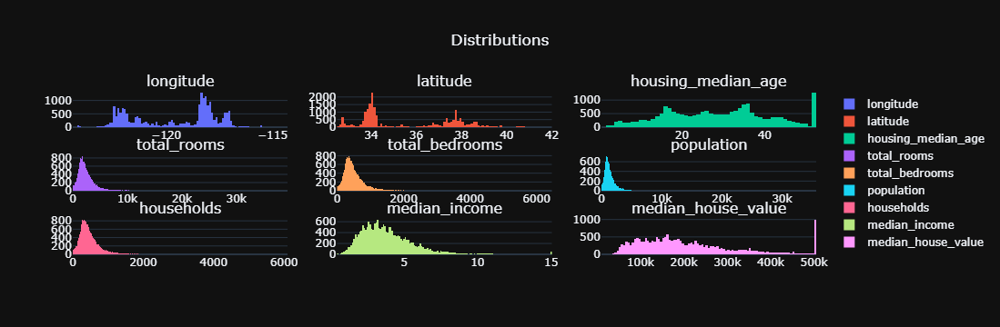

In [24]:
fig = make_subplots(rows=3, cols=3, subplot_titles=('longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 
                                                    'households', 'median_income', 'median_house_value'))

fig.add_trace(go.Histogram(x=df_work['longitude'], name='longitude'), row=1, col=1)
fig.add_trace(go.Histogram(x=df_work['latitude'], name='latitude'), row=1, col=2)
fig.add_trace(go.Histogram(x=df_work['housing_median_age'], name='housing_median_age'), row=1, col=3)
fig.add_trace(go.Histogram(x=df_work['total_rooms'], name='total_rooms'), row=2, col=1)
fig.add_trace(go.Histogram(x=df_work['total_bedrooms'], name='total_bedrooms'), row=2, col=2)
fig.add_trace(go.Histogram(x=df_work['population'], name='population'), row=2, col=3)
fig.add_trace(go.Histogram(x=df_work['households'], name='households'), row=3, col=1)
fig.add_trace(go.Histogram(x=df_work['median_income'], name='median_income'), row=3, col=2)
fig.add_trace(go.Histogram(x=df_work['median_house_value'], name='median_house_value'), row=3,col=3)
fig.update_layout(template='plotly_dark', title_text='Distributions', title_x=0.5)


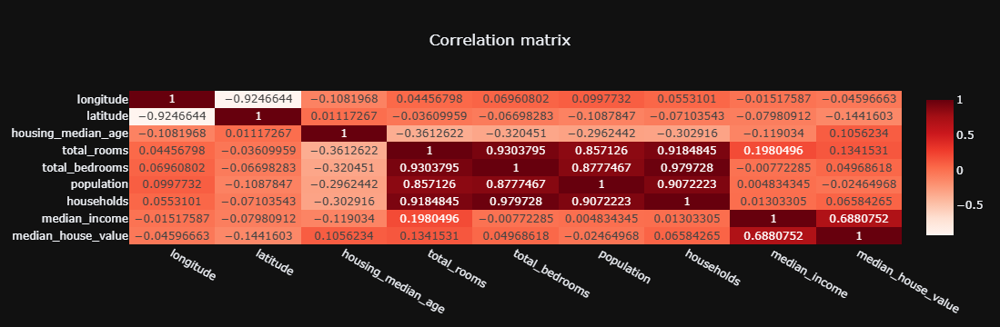

In [25]:
fig=px.imshow(df_work.select_dtypes(include = 'float').corr(),text_auto=True, template='plotly_dark', color_continuous_scale=px.colors.sequential.Reds, 
              aspect='auto',title='Correlation matrix')

fig.update_layout(title_x=0.5)
fig.show()

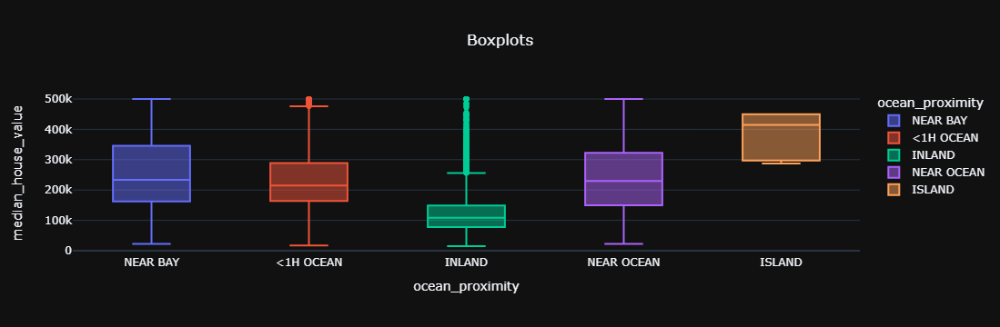

In [26]:
fig = px.box(df, x="ocean_proximity", y="median_house_value", template='plotly_dark', title='Boxplots', color='ocean_proximity')
fig.update_layout(title_x=0.5)
fig.show()

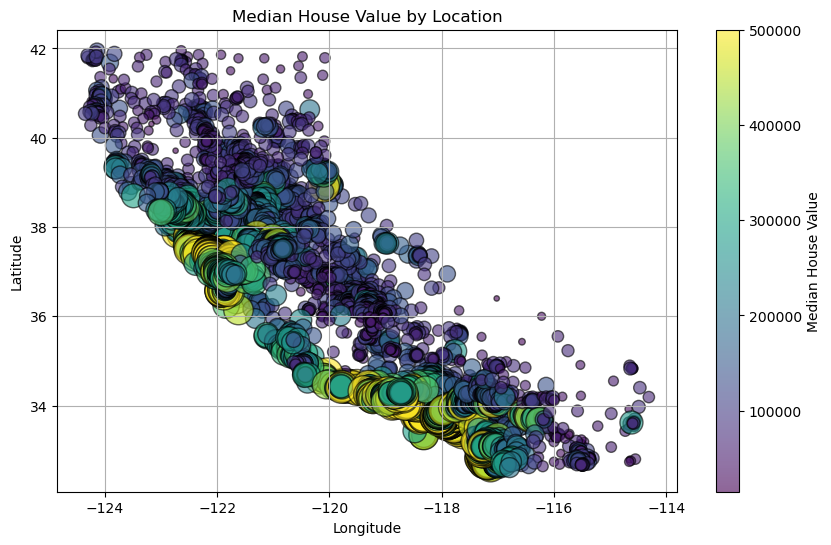

In [27]:
plt.figure(figsize=(10, 6))
plt.scatter(
    df['longitude'],
    df['latitude'],
    s=df['median_house_value'] / 1000,  # bubble size scaled down
    c=df['median_house_value'],
    cmap='viridis',
    alpha=0.6,
    edgecolor='k'
)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Median House Value by Location')
plt.colorbar(label='Median House Value')
plt.grid(True)
plt.show()


#### Missing Value გვხვდება მხოლო TotalBedroom-ის სვეტში. განაწილებების შეხედვისას აღმოჩნდა რომ თვითონ ეგ სვეტიც და მთლიანად ბაზა შეიცავს ბევრ     Outlier-ს, ძირითადად ბოლო 2 Percentile-ზე. დისტრიბუციას კუდი აქვს მარჯვნივ მაგიტომაც ჯობია Median მნიშვნელობებით შევავსოთ ჩვენი Missing Value-ები. Outlier-ების საპოვნელად გამოვიყენებ IQR მეთოდს. ჩარტებში ასევე გამოჩნდა რომ MedianIncome სვეტი მაღალ კორელაციაშია ჩვენს თარგეთთან, ეგ სვეტი მნიშვნელოვანია. ასევე ვხედავთ რომ ჩვენი Input სვეტებიდან ზოგი მჭიდრო კორელაციაშია ერთმანეთთან. მაგალითად TotalRooms და TotalBedRooms, ერთერთის ჩვენს მოდელში შეყვანით, მეორეს ღირებულება მცირდება რადგანაც ეს ორი ძაან მიახლოებულ ინფორმაციას გვიყვება. უნდა ვეცადოთ ამ სვეტების კომბინაციებისგან შევქმნათ ახალი სვეტები, რომლებიც შეიძლება გამოადგეს მოდელს. BoxPlot-ში გამოჩნდა რომ ყველა ჩვენი Categorical სვეტის მნიშვნელობები ასე თუ ისე ერთმანეთისგან განსხვავებულ ინფორმაციას იძლევა, მაგიტომაც მათგან რომელიმეს ამოგდება არ იქნება საჭირო. Scatter ჩარტი გვეუბნება რომ Longtitude და Latitude სვეტების კომბინაცია საინტერესო ინფორმაციას გვაძლევს. ჩარტზევე ჩანს რომ ზოგიერთ რეგიონში უფრო მჭირდოდ არის დიდი Value-ს მქონე სახლები. ამ ორი სვეტისგანაც შეიძლება კომბინაციური ფიჩერის შექმნა

### გავყოთ დატა Test/Train-ად. ტერმინები Train/Test არის პირველადი გაყოფის შედეგები. ტერმინები Train1/Test1 არის Null მნიშვნელობების შევსება. ტერმინები Train2/Test2 იქნება Outliers მოშორება. Train3/Test3 იქნება Feature-ბის დამატება. Train4/Test4 იქნება LabelEncoding, Train_Final/Test_Final იქნება სკალირებილი, ანუ საბოლოო ვერსია 

In [28]:
x_train, x_test, y_train, y_test = train_test_split(df_work.drop(['median_house_value'],axis=1), 
                                                    df_work['median_house_value'], test_size=0.3, random_state=42)

In [29]:
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((14448, 9), (6192, 9), (14448,), (6192,))

## Missing Values

In [30]:
x_train1 = x_train.copy()
x_test1 = x_test.copy()

x_train1['total_bedrooms'] = x_train['total_bedrooms'].fillna(x_train['total_bedrooms'].median())
x_test1['total_bedrooms'] = x_test['total_bedrooms'].fillna(x_train['total_bedrooms'].median())

In [31]:
x_train1.shape, x_test1.shape, y_train.shape, y_test.shape

((14448, 9), (6192, 9), (14448,), (6192,))

In [32]:
x_train1['total_bedrooms'].isnull().sum()

0

In [34]:
x_train1.head(1)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
7061,-118.019997,33.93,35.0,2400.0,398.0,1218.0,408.0,4.1312,<1H OCEAN


## Handling Outliers 2 ვარიანტი ან წავშალოთ ან კიდის მნიშვნელობა მივანიჭოთ

In [35]:
# def get_outlier_bounds(series):
#     q1 = series.quantile(0.05)
#     q3 = series.quantile(0.95)
#     iqr = q3 - q1
#     return q1 - 1.5 * iqr, q3 + 1.5 * iqr, q1, q3  # also return original Q1, Q3 for capping

# def cap_outliers(df, bounds_dict):
#     df_capped = df.copy()
#     for col, (low, high, q1, q3) in bounds_dict.items():
#         df_capped[col] = df_capped[col].clip(lower=q1, upper=q3)
#     return df_capped

In [36]:
# # Get bounds and quartiles for each float column
# float_cols = x_train.select_dtypes(include='float').columns
# bounds = {col: get_outlier_bounds(x_train[col]) for col in float_cols}

# # Apply winsorization to both train and test sets
# x_train_capped = cap_outliers(x_train1, bounds)
# x_test_capped = cap_outliers(x_test1, bounds)


In [37]:
# y_train_final = y_train.loc[x_train_capped.index]
# y_test_final = y_test.loc[x_test_capped.index]

In [38]:
# x_train_capped.shape, x_test_capped.shape, y_train_final.shape, y_test_final.shape

In [39]:
# fig = make_subplots(rows=3, cols=3, subplot_titles=('longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 
#                                                     'households', 'median_income', 'median_house_value'))

# fig.add_trace(go.Histogram(x=x_train_capped['longitude'], name='longitude'), row=1, col=1)
# fig.add_trace(go.Histogram(x=x_train_capped['latitude'], name='latitude'), row=1, col=2)
# fig.add_trace(go.Histogram(x=x_train_capped['housing_median_age'], name='housing_median_age'), row=1, col=3)
# fig.add_trace(go.Histogram(x=x_train_capped['total_rooms'], name='total_rooms'), row=2, col=1)
# fig.add_trace(go.Histogram(x=x_train_capped['total_bedrooms'], name='total_bedrooms'), row=2, col=2)
# fig.add_trace(go.Histogram(x=x_train_capped['population'], name='population'), row=2, col=3)
# fig.add_trace(go.Histogram(x=x_train_capped['households'], name='households'), row=3, col=1)
# fig.add_trace(go.Histogram(x=x_train_capped['median_income'], name='median_income'), row=3, col=2)
# fig.update_layout(template='plotly_dark', title_text='Distributions', title_x=0.5)


In [33]:
def get_outlier_bounds(series):
    q1 = series.quantile(0.05)
    q3 = series.quantile(0.95)
    iqr = q3 - q1
    return q1 - 1.5 * iqr, q3 + 1.5 * iqr

def remove_outliers_from_df(df, bounds_dict):
    df_filtered = df.copy()
    for col, (low, high) in bounds_dict.items():
        df_filtered = df_filtered[(df_filtered[col] >= low) | (df_filtered[col].isna())]
        df_filtered = df_filtered[(df_filtered[col] <= high) | (df_filtered[col].isna())]
    return df_filtered

In [34]:
# Calculate outlier bounds only from x_train
float_cols = x_train1.select_dtypes(include='float').columns
bounds = {col: get_outlier_bounds(x_train1[col]) for col in float_cols}

# Apply to x_train and x_test
x_train2 = remove_outliers_from_df(x_train1, bounds)
x_test2 = remove_outliers_from_df(x_test1, bounds)

# Filter y to match cleaned x
y_train_final = y_train.loc[x_train2.index]
y_test_final = y_test.loc[x_test2.index]


In [35]:
x_train2.shape, x_test2.shape, y_train_final.shape, y_test_final.shape

((14361, 9), (6147, 9), (14361,), (6147,))

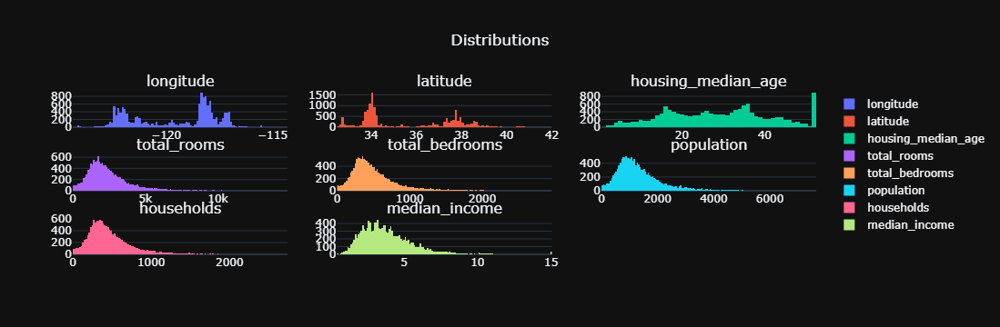

In [36]:
fig = make_subplots(rows=3, cols=3, subplot_titles=('longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 
                                                    'households', 'median_income'))

fig.add_trace(go.Histogram(x=x_train2['longitude'], name='longitude'), row=1, col=1)
fig.add_trace(go.Histogram(x=x_train2['latitude'], name='latitude'), row=1, col=2)
fig.add_trace(go.Histogram(x=x_train2['housing_median_age'], name='housing_median_age'), row=1, col=3)
fig.add_trace(go.Histogram(x=x_train2['total_rooms'], name='total_rooms'), row=2, col=1)
fig.add_trace(go.Histogram(x=x_train2['total_bedrooms'], name='total_bedrooms'), row=2, col=2)
fig.add_trace(go.Histogram(x=x_train2['population'], name='population'), row=2, col=3)
fig.add_trace(go.Histogram(x=x_train2['households'], name='households'), row=3, col=1)
fig.add_trace(go.Histogram(x=x_train2['median_income'], name='median_income'), row=3, col=2)
fig.update_layout(template='plotly_dark', title_text='Distributions', title_x=0.5)


In [38]:
x_train2.head(1)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
7061,-118.019997,33.93,35.0,2400.0,398.0,1218.0,408.0,4.1312,<1H OCEAN


## Creating New Features

In [73]:
# numeric_cols = x_train2.select_dtypes(include=['number']).columns.tolist()

# # Remove the two columns by name
# numeric_cols = [col for col in numeric_cols if col not in ['longitude', 'latitude']]

# print(numeric_cols)


['housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income']


In [37]:
def add_features(df):
    df = df.copy()
    
    # Base engineered features
    df['rooms_per_household'] = df['total_rooms'] / df['households']
    df['bedrooms_per_room'] = df['total_bedrooms'] / df['total_rooms']
    df['population_per_household'] = df['population'] / df['households']
    df['population_density'] = df['population'] / df['total_rooms']
    
    # df['location_sum'] = df['longitude'] + df['latitude']
    # df['location_diff'] = df['longitude'] - df['latitude']
    
    # df['location_div'] = df['longitude'] / df['latitude']

    # Binning features
    df['income_cat'] = pd.cut(df['median_income'], bins=[0, 2, 4, 6, 8, 15], labels=[1, 2, 3, 4, 5])
    df['age_bin'] = pd.cut(df['housing_median_age'], bins=[0, 10, 20, 30, 40, 55], labels=[1, 2, 3, 4, 5])
    

    # ლოგარითმები და კვადრატები
    numeric_cols = df.select_dtypes(include=['number']).columns.tolist()

    # Remove the two columns by name
    numeric_cols = [col for col in numeric_cols if col not in ['longitude', 'latitude']]
    
    for col in numeric_cols:
        df[f'log_{col}'] = np.log1p(df[col])          # log(x + 1)
    #     df[f'sq_{col}'] = df[col] ** 2                # square

    # წავშალოთ მაღალი კორელაციის სვეტები
    # df = df.drop(['total_rooms', 'households', 'total_bedrooms', 'population'], axis = 1)

    return df


In [38]:
x_train3 = add_features(x_train2)
x_test3 = add_features(x_test2)

In [39]:
x_train3 = x_train3.dropna(axis=1)
x_test3 = x_test3.dropna(axis=1)

In [40]:
x_train3.isnull().sum()

longitude                       0
latitude                        0
housing_median_age              0
total_rooms                     0
total_bedrooms                  0
population                      0
households                      0
median_income                   0
ocean_proximity                 0
rooms_per_household             0
bedrooms_per_room               0
population_per_household        0
population_density              0
age_bin                         0
log_housing_median_age          0
log_total_rooms                 0
log_total_bedrooms              0
log_population                  0
log_households                  0
log_median_income               0
log_rooms_per_household         0
log_bedrooms_per_room           0
log_population_per_household    0
log_population_density          0
dtype: int64

In [78]:
x_train3.shape, x_test3.shape, y_train_final.shape, y_test_final.shape

((14361, 24), (6147, 24), (14361,), (6147,))

In [79]:
x_train3.head(1)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity,rooms_per_household,...,log_housing_median_age,log_total_rooms,log_total_bedrooms,log_population,log_households,log_median_income,log_rooms_per_household,log_bedrooms_per_room,log_population_per_household,log_population_density
7061,-118.019997,33.93,35.0,2400.0,398.0,1218.0,408.0,4.1312,<1H OCEAN,5.882353,...,3.583519,7.78364,5.988961,7.105786,6.013715,1.635339,1.928961,0.153436,1.382611,0.410453


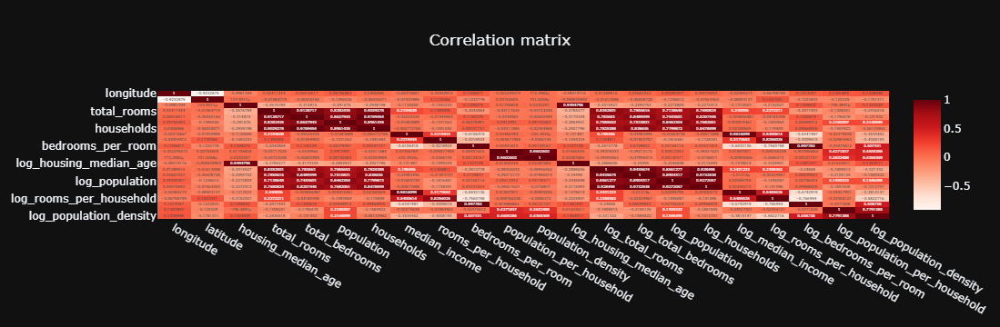

In [80]:
fig=px.imshow(x_train3.select_dtypes(include = 'float').corr(),text_auto=True, template='plotly_dark', color_continuous_scale=px.colors.sequential.Reds, 
              aspect='auto',title='Correlation matrix')

fig.update_layout(title_x=0.5)
fig.show()

## LabelEncoding

In [41]:
label_encoder = LabelEncoder()

In [42]:
x_train4 = x_train3.copy()
x_test4 = x_test3.copy()

x_train4['ocean_proximity_label'] = label_encoder.fit_transform(x_train3.ocean_proximity)
x_test4['ocean_proximity_label'] = label_encoder.transform(x_test3.ocean_proximity)

x_train4.drop(['ocean_proximity'],axis=1,inplace=True)
x_test4.drop(['ocean_proximity'],axis=1,inplace=True)

In [43]:
x_train4.shape, x_test4.shape, y_train_final.shape, y_test_final.shape

((14361, 24), (6147, 24), (14361,), (6147,))

In [84]:
x_train4.head(1)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,bedrooms_per_room,...,log_total_rooms,log_total_bedrooms,log_population,log_households,log_median_income,log_rooms_per_household,log_bedrooms_per_room,log_population_per_household,log_population_density,ocean_proximity_label
7061,-118.019997,33.93,35.0,2400.0,398.0,1218.0,408.0,4.1312,5.882353,0.165833,...,7.78364,5.988961,7.105786,6.013715,1.635339,1.928961,0.153436,1.382611,0.410453,0


## Standarisation

In [44]:
standart = StandardScaler()

In [45]:
columns = x_train4.columns

In [46]:
x_train_final = standart.fit_transform(x_train4)
x_train_final = pd.DataFrame(x_train_final, columns=columns, index=x_train4.index)

In [47]:
x_test_final = standart.transform(x_test4)
x_test_final = pd.DataFrame(x_test_final, columns=columns, index=x_test4.index)

In [48]:
x_train_final.shape, x_test_final.shape, y_train_final.shape, y_test_final.shape

((14361, 24), (6147, 24), (14361,), (6147,))

In [49]:
x_train_final.head(1)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,rooms_per_household,bedrooms_per_room,...,log_total_rooms,log_total_bedrooms,log_population,log_households,log_median_income,log_rooms_per_household,log_bedrooms_per_room,log_population_per_household,log_population_density,ocean_proximity_label
7061,0.783025,-0.807307,0.502792,-0.086817,-0.351463,-0.17739,-0.24073,0.136757,0.182489,-0.810951,...,0.221239,-0.080789,0.124595,0.053221,0.32996,0.428112,-0.840974,0.147073,-0.255379,-0.818795


## დისტრიბუციებს შევხედოთ კიდევ ერთხელ

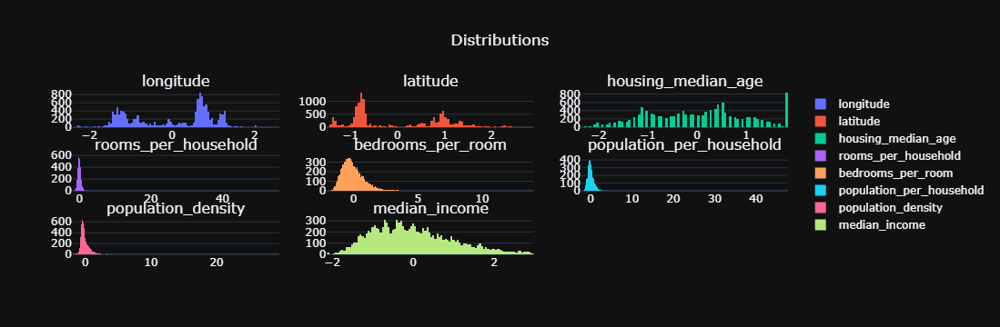

In [671]:
fig = make_subplots(rows=3, cols=3, subplot_titles=('longitude', 'latitude', 'housing_median_age', 'rooms_per_household', 'bedrooms_per_room', 'population_per_household', 
                                                    'population_density', 'median_income'))

fig.add_trace(go.Histogram(x=x_train_final['longitude'], name='longitude'), row=1, col=1)
fig.add_trace(go.Histogram(x=x_train_final['latitude'], name='latitude'), row=1, col=2)
fig.add_trace(go.Histogram(x=x_train_final['housing_median_age'], name='housing_median_age'), row=1, col=3)
fig.add_trace(go.Histogram(x=x_train_final['rooms_per_household'], name='rooms_per_household'), row=2, col=1)
fig.add_trace(go.Histogram(x=x_train_final['bedrooms_per_room'], name='bedrooms_per_room'), row=2, col=2)
fig.add_trace(go.Histogram(x=x_train_final['population_per_household'], name='population_per_household'), row=2, col=3)
fig.add_trace(go.Histogram(x=x_train_final['population_density'], name='population_density'), row=3, col=1)
fig.add_trace(go.Histogram(x=x_train_final['median_income'], name='median_income'), row=3, col=2)
fig.update_layout(template='plotly_dark', title_text='Distributions', title_x=0.5)


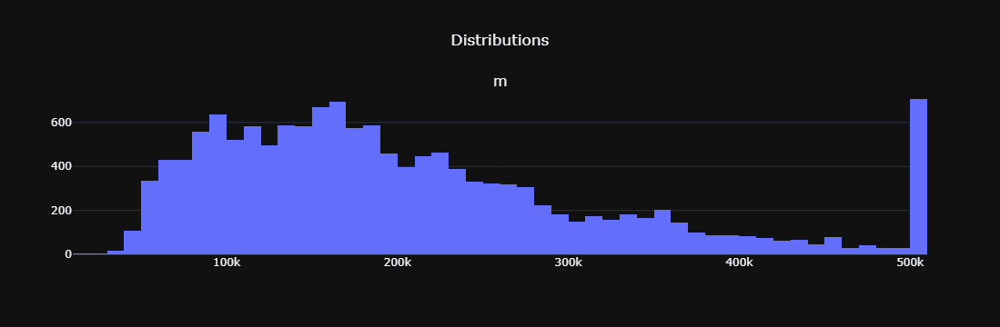

In [91]:
fig = make_subplots(rows=1, cols=1, subplot_titles=('median_house_value'))

fig.add_trace(go.Histogram(x=y_train_final, name='median_house_value'), row=1, col=1)

fig.update_layout(template='plotly_dark', title_text='Distributions', title_x=0.5)

## ეს ყველაფერი ერთ ფაიფლაინად

In [672]:
# import pandas as pd
# import numpy as np
# from sklearn.base import BaseEstimator, TransformerMixin
# from sklearn.preprocessing import LabelEncoder, StandardScaler
# from sklearn.pipeline import Pipeline
# from sklearn.compose import ColumnTransformer, make_column_selector

# 1. Median Imputation Transformer
class MedianImputer(BaseEstimator, TransformerMixin):
    def __init__(self, column):
        self.column = column
        self.median = None

    def fit(self, X, y=None):
        self.median = X[self.column].median()
        return self

    def transform(self, X):
        X = X.copy()
        X[self.column] = X[self.column].fillna(self.median)
        return X

# 2. Outlier Removal Transformer
class OutlierRemover(BaseEstimator, TransformerMixin):
    def __init__(self, float_columns):
        self.float_columns = float_columns
        self.bounds = {}

    def fit(self, X, y=None):
        for col in self.float_columns:
            q1 = X[col].quantile(0.25)
            q3 = X[col].quantile(0.75)
            iqr = q3 - q1
            self.bounds[col] = (q1 - 1.5 * iqr, q3 + 1.5 * iqr)
        return self

    def transform(self, X):
        X = X.copy()
        for col, (low, high) in self.bounds.items():
            X = X[(X[col] >= low) | (X[col].isna())]
            X = X[(X[col] <= high) | (X[col].isna())]
        return X

class FeatureEngineer(BaseEstimator, TransformerMixin):
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        df = X.copy()
        df['rooms_per_household'] = df['total_rooms'] / df['households']
        df['bedrooms_per_room'] = df['total_bedrooms'] / df['total_rooms']
        df['population_per_household'] = df['population'] / df['households']
        df['population_density'] = df['population'] / df['total_rooms']
        df['income_cat'] = pd.cut(df['median_income'], bins=[0, 2, 4, 6, 8, 15], labels=[1, 2, 3, 4, 5])
        df['age_bin'] = pd.cut(df['housing_median_age'], bins=[0, 10, 20, 30, 40, 55], labels=[1, 2, 3, 4, 5])
        df = df.drop(['total_rooms', 'households', 'total_bedrooms', 'population'], axis = 1)
    
        return df


# 4. Label Encoding Transformer
class LabelEncoderWrapper(BaseEstimator, TransformerMixin):
    def __init__(self, column):
        self.column = column
        self.encoder = LabelEncoder()

    def fit(self, X, y=None):
        self.encoder.fit(X[self.column])
        return self

    def transform(self, X):
        X = X.copy()
        X[self.column + '_label'] = self.encoder.transform(X[self.column])
        X.drop(columns=[self.column], inplace=True)
        return X

# ✅ 5. FINAL PIPELINE FUNCTION — this was missing
def create_cleaning_pipeline(float_columns):
    return Pipeline(steps=[
        ('imputer', MedianImputer(column='total_bedrooms')),
        ('outlier_removal', OutlierRemover(float_columns=float_columns)),
        ('feature_engineering', FeatureEngineer()),
        ('label_encoding', LabelEncoderWrapper(column='ocean_proximity')),
        ('scaling', ColumnTransformer([
            ('scaler', StandardScaler(), make_column_selector(dtype_include=np.number))
        ], remainder='passthrough'))
    ])


In [673]:
def clean_data_with_pipeline(x_train, y_train, x_test, y_test):
    float_columns = x_train.select_dtypes(include='float').columns.tolist()
    
    # Create and fit imputer
    imputer = MedianImputer(column='total_bedrooms')
    x_train_imputed = imputer.fit_transform(x_train)
    x_test_imputed = imputer.transform(x_test)
    
    # Create and fit outlier remover
    outlier_remover = OutlierRemover(float_columns=float_columns)
    x_train_filtered = outlier_remover.fit_transform(x_train_imputed)
    kept_train_indices = x_train_filtered.index
    x_train_final = x_train_filtered
    y_train_final = y_train.loc[kept_train_indices]
    
    # Apply same bounds to test set
    x_test_filtered = outlier_remover.transform(x_test_imputed)
    kept_test_indices = x_test_filtered.index
    x_test_final = x_test_filtered
    y_test_final = y_test.loc[kept_test_indices]
    
    return x_train_final, y_train_final, x_test_final, y_test_final, (imputer, outlier_remover)


In [507]:
float_cols = x_train.select_dtypes(include='float').columns.tolist()
pipeline = create_cleaning_pipeline(float_cols)

x_train_final_linear = pipeline.fit_transform(x_train)
x_test_final_linear = pipeline.transform(x_test)


In [508]:
x_train_final1, y_train_final_linear, x_test_final1, y_test_final_linear, pipe = clean_data_with_pipeline(
    x_train, y_train, x_test, y_test
)


In [460]:
columns = x_train_final.columns

In [511]:
x_train_final_linear = pd.DataFrame(x_train_final_linear, columns=columns, index=x_train_final.index)
x_test_final_linear = pd.DataFrame(x_test_final_linear, columns=columns, index=x_test_final.index)

In [674]:
x_train_final.shape, x_test_final.shape, y_train_final.shape, y_test_final.shape

((12718, 11), (5487, 11), (12718,), (5487,))

## ვავარჯიშოთ მოდელები Tune-ის გარეშე

In [50]:
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

In [51]:
df_models = pd.DataFrame(columns=['Algorithm', 'r2_train', 'r2_test', 'MAE_train', 'MAE_test', 'MSE_train', 'MSE_test'])

def make_model(X_tr, X_te, y_tr, y_te, model, model_name: str): 
    model.fit(X_tr, y_tr)
    y_pred_train = model.predict(X_tr)
    y_pred_test = model.predict(X_te)

    r2_train = r2_score(y_tr, y_pred_train)
    r2_test = r2_score(y_te, y_pred_test)
    MAE_train = mean_absolute_error(y_tr, y_pred_train)
    MAE_test = mean_absolute_error(y_te, y_pred_test)
    MSE_train = mean_squared_error(y_tr, y_pred_train, squared=False)
    MSE_test = mean_squared_error(y_te, y_pred_test, squared=False)
    

    df_models.loc[len(df_models.index)] = [model_name, r2_train, r2_test, MAE_train, MAE_test, MSE_train, MSE_test]

                       

make_model(x_train_final, x_test_final, y_train_final, y_test_final, LinearRegression(), 'LinearRegression')
make_model(x_train_final, x_test_final, y_train_final, y_test_final, Ridge(), 'Ridge')
make_model(x_train_final, x_test_final, y_train_final, y_test_final, Lasso(), 'Lasso')
make_model(x_train_final, x_test_final, y_train_final, y_test_final, GradientBoostingRegressor(), 'GradientBoosting')
make_model(x_train_final, x_test_final, y_train_final, y_test_final, RandomForestRegressor(), 'RandomForest')


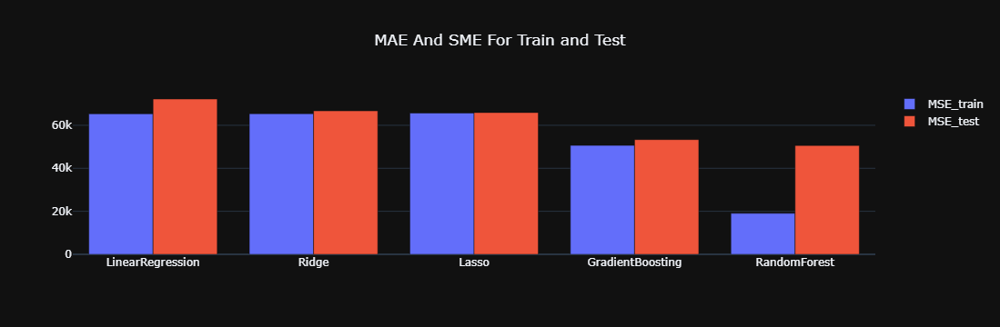

In [52]:
fig = go.Figure(data=[
    # go.Bar(name='r2_train', x=df_models.Algorithm, y=df_models.r2_train),
    # go.Bar(name='r2_test', x=df_models.Algorithm, y=df_models.r2_test),
    # go.Bar(name='MAE_train', x=df_models.Algorithm, y=df_models.MAE_train),
    # go.Bar(name='MAE_test', x=df_models.Algorithm, y=df_models.MAE_test),
    go.Bar(name='MSE_train', x=df_models.Algorithm, y=df_models.MSE_train),
    go.Bar(name='MSE_test', x=df_models.Algorithm, y=df_models.MSE_test),
    
])
fig.update_layout(template='plotly_dark', title='MAE And SME For Train and Test', title_x=0.5)

### დავიწყეთ თვითონ ჩვენი Variable-ბის შეფასება Significance-ის მიხედვით. თუ რამდენად დაგვეხმარება Y-ის დაფრედიქთებაში (RandomForest)

In [96]:
x_train_final.shape, x_test_final.shape

((14361, 24), (6147, 24))

In [520]:
model = RandomForestRegressor().fit(x_train_final, y_train_final)
importances = pd.Series(model.feature_importances_, index=x_train_final.columns)
top_10 = importances.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 features by model importance:", top_10)


Top 10 features by model importance: ['location_sum', 'population_density', 'median_income', 'income_age_interaction', 'population_per_household', 'location_div', 'location_diff', 'longitude', 'bedrooms_per_room', 'latitude']


In [102]:
from sklearn.feature_selection import SelectKBest, f_regression
def k_best_feature_selection_rf(X_train, X_test, y_train, y_test, k=24, random_state=42):
    # Step 1: Feature selection
    selector = SelectKBest(score_func=f_regression, k=k)
    X_train_kbest = selector.fit_transform(X_train, y_train)
    X_test_kbest = selector.transform(X_test)

    # Get names of selected features
    selected_features = X_train.columns[selector.get_support()]
    print(f"Top {k} features selected:", list(selected_features))

    # Step 2: Train Random Forest
    rf = RandomForestRegressor(random_state=random_state)
    rf.fit(X_train_kbest, y_train)

    # Step 3: Predict and Evaluate
    y_train_pred = rf.predict(X_train_kbest)
    y_test_pred = rf.predict(X_test_kbest)

    print(f"R² Train: {r2_score(y_train, y_train_pred):.4f}")
    print(f"R² Test: {r2_score(y_test, y_test_pred):.4f}")
    print(f"MAE Train: {mean_absolute_error(y_train, y_train_pred):.2f}")
    print(f"MAE Test: {mean_absolute_error(y_test, y_test_pred):.2f}")
    print(f"RMSE Train: {mean_squared_error(y_train, y_train_pred, squared=False):.2f}")
    print(f"RMSE Test: {mean_squared_error(y_test, y_test_pred, squared=False):.2f}")

    return rf, selected_features


In [103]:
model_rf, top_features_random_forest = k_best_feature_selection_rf(x_train_final, x_test_final, y_train_final, y_test_final, k=24)

Top 24 features selected: ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'population', 'households', 'median_income', 'rooms_per_household', 'bedrooms_per_room', 'population_per_household', 'population_density', 'age_bin', 'log_housing_median_age', 'log_total_rooms', 'log_total_bedrooms', 'log_population', 'log_households', 'log_median_income', 'log_rooms_per_household', 'log_bedrooms_per_room', 'log_population_per_household', 'log_population_density', 'ocean_proximity_label']
R² Train: 0.9729
R² Test: 0.8080
MAE Train: 12337.61
MAE Test: 32828.94
RMSE Train: 19064.03
RMSE Test: 50247.40


In [101]:
# Train on all features
rf_all = RandomForestRegressor(random_state=42)
rf_all.fit(x_train_final, y_train_final)
r2_all = r2_score(y_train_final, rf_all.predict(x_train_final))

# Train on selected features
X_train_random_forest = x_train_final[top_features_random_forest]  # Replace with your actual selected feature list
rf_selected = RandomForestRegressor(random_state=42)
rf_selected.fit(X_train_random_forest, y_train_final)
r2_selected = r2_score(y_train_final, rf_selected.predict(X_train_random_forest))

# Comparison
print(f"R² with all features:      {r2_all:.4f}")
print(f"R² with selected features: {r2_selected:.4f}")
print(f"Variance retained:         {(r2_selected / r2_all) * 100:.2f}%")


R² with all features:      0.9729
R² with selected features: 0.9623
Variance retained:         98.91%


In [55]:
from sklearn.model_selection import GridSearchCV, cross_val_score
# from sklearn.ensemble import RandomForestRegressor

# Define parameter grid
param_grid = {
    'criterion': ['squared_error'],#, 'absolute_error' 'friedman_mse', 'poisson'],
    'n_estimators': [500],
    'max_depth': [25],
    'min_samples_split': [2],
    'min_samples_leaf': [2],
    'min_weight_fraction_leaf': [0.0],
    'max_features': [1.0],
    'max_leaf_nodes': [None],
    'min_impurity_decrease': [0.0],
}

# Grid search
grid_search = GridSearchCV(
    RandomForestRegressor(random_state=42),
    param_grid,
    cv=3,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=1
)

# Fit on training data
grid_search.fit(x_train_final, y_train_final)

# Best model
best_rf = grid_search.best_estimator_
print("Best Parameters:", grid_search.best_params_)

# Evaluate on train/test
# make_model(x_train_final, x_test_final, y_train_final, y_test_final, best_rf, 'RandomForest_Tuned')

# Cross-validation R²
cv_scores = cross_val_score(best_rf, x_train_final, y_train_final, cv=3, scoring='r2')
print("Cross-validated r2 scores:", cv_scores)
print("Mean CV r2:", cv_scores.mean())


Fitting 3 folds for each of 2 candidates, totalling 6 fits


KeyboardInterrupt: 

In [ ]:
best_rf

In [ ]:
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
# import numpy as np

# # 1. Use best parameters to create a new model
best_rf = RandomForestRegressor(
    criterion = 'squared_error',
    n_estimators = 500,
    max_depth = 25,
    min_samples_split = 2,
    min_samples_leaf = 2,
    min_weight_fraction_leaf = 0.0,
    max_features = 1.0,
    max_leaf_nodes = None,
    min_impurity_decrease = 0.0
    # bootstrap=True,
    # oob_score=False,
    # n_jobs=-1,
    # random_state=None,
    # verbose=0,
    # warm_start=False,
    # ccp_alpha=0.0,
    # max_samples=None
)

# # 2. Fit model
best_rf.fit(x_train_final, y_train_final)

# 3. Predict
y_pred_train = best_rf.predict(x_train_final)
y_pred_test = best_rf.predict(x_test_final)

In [167]:
# 4. Metrics
# r2_train = r2_score(y_train_final, y_pred_train)
# r2_test = r2_score(y_test_final, y_pred_test)

# mae_train = mean_absolute_error(y_train_final, y_pred_train)
# mae_test = mean_absolute_error(y_test_final, y_pred_test)

mse_train = mean_squared_error(y_train_final, y_pred_train, squared=False)
mse_test = mean_squared_error(y_test_final, y_pred_test, squared=False)

# # 5. Print results
# print(f"R² Train: {r2_train:.4f}")
# print(f"R² Test:  {r2_test:.4f}")
# print(f"MAE Train: {mae_train:.2f}")
# print(f"MAE Test:  {mae_test:.2f}")
print(f"MSE Train: {mse_train:.2f}")
print(f"MSE Test:  {mse_test:.2f}")

MSE Train: 23449.37
MSE Test:  49813.96


## GradientBoosting

In [483]:
x_train_final.shape, x_test_final.shape

((12718, 19), (5487, 19))

In [484]:
model = GradientBoostingRegressor().fit(x_train_final, y_train_final)
importances = pd.Series(model.feature_importances_, index=x_train_final.columns)
top_10 = importances.sort_values(ascending=False).head(10).index.tolist()
print("Top 10 features by model importance:", top_10)


Top 10 features by model importance: ['location_sum', 'median_income', 'population_density', 'income_age_interaction', 'population_per_household', 'location_diff', 'location_div', 'longitude', 'latitude', 'bedrooms_per_room']


In [485]:
# from sklearn.inspection import permutation_importance
# from sklearn.ensemble import RandomForestRegressor
# import pandas as pd

# Train model
model = GradientBoostingRegressor(random_state=42)
model.fit(x_train_final, y_train_final)

# Get permutation importances
result = permutation_importance(model, x_train_final, y_train_final, n_repeats=10, random_state=42)

# Build table
importances_df = pd.DataFrame({
    'Feature': x_train_final.columns,
    'Importance_Mean': result.importances_mean,
    'Importance_Std': result.importances_std
}).sort_values(by='Importance_Mean', ascending=False)

# Show full table
print(importances_df)


                     Feature  Importance_Mean  Importance_Std
12              location_sum         0.315673        0.004737
7              median_income         0.235263        0.002585
13             location_diff         0.073523        0.001607
10  population_per_household         0.066587        0.002147
11        population_density         0.052323        0.000734
14              location_div         0.050403        0.001058
0                  longitude         0.043741        0.001109
15    income_age_interaction         0.040186        0.001582
1                   latitude         0.035864        0.001011
9          bedrooms_per_room         0.009032        0.000394
8        rooms_per_household         0.005941        0.000226
2         housing_median_age         0.005610        0.000399
4             total_bedrooms         0.003261        0.000246
18     ocean_proximity_label         0.001951        0.000172
3                total_rooms         0.000828        0.000160
6       

In [489]:
# from sklearn.ensemble import GradientBoostingRegressor
# from boruta import BorutaPy

# GradientBoostingRegressor does NOT support n_jobs
rf = GradientBoostingRegressor(max_depth=5)

boruta = BorutaPy(estimator=rf, n_estimators='auto', random_state=42)
boruta.fit(x_train_final.values, y_train_final.values)

# selected_features = x_train_final.columns[boruta.support_].tolist()
# print("Selected features:", selected_features)


Selected features: ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'median_income', 'rooms_per_household', 'bedrooms_per_room', 'population_per_household', 'population_density', 'location_sum', 'location_diff', 'location_div', 'income_age_interaction', 'ocean_proximity_label']


In [491]:
selected_features_GradientBoosting = x_train_final.columns[boruta.support_].tolist()
print("Selected features:", selected_features_GradientBoosting)

Selected features: ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'median_income', 'rooms_per_household', 'bedrooms_per_room', 'population_per_household', 'population_density', 'location_sum', 'location_diff', 'location_div', 'income_age_interaction', 'ocean_proximity_label']


In [492]:
x_train_final = x_train_final[selected_features_GradientBoosting]
x_test_final = x_test_final[selected_features_GradientBoosting]

In [493]:
# from sklearn.ensemble import GradientBoostingRegressor
# from sklearn.model_selection import GridSearchCV, cross_val_score

# Expanded parameter grid
param_grid_gbr = {
    'n_estimators': [100, 300, 500, 700],
    'max_depth': [3, 4, 5, 6],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    # 'min_samples_split': [2, 5, 10],
    # 'min_samples_leaf': [1, 3, 5],
    # 'subsample': [0.6, 0.8, 1.0]  # Controls row sampling (regularization)
}

# Grid search setup
grid_search_gbr = GridSearchCV(
    GradientBoostingRegressor(random_state=42),
    param_grid=param_grid_gbr,
    cv=5,
    scoring='r2',
    n_jobs=-1,
    verbose=1
)

# Fit to training data
grid_search_gbr.fit(x_train_final, y_train_final)

# Get best model
best_gbr = grid_search_gbr.best_estimator_
print("Best Parameters:", grid_search_gbr.best_params_)

# Evaluate on train/test
make_model(x_train_final, x_test_final, y_train_final, y_test_final, best_gbr, 'GradientBoosting_Tuned')

# Cross-validation R²
cv_scores_gbr = cross_val_score(best_gbr, x_train_final, y_train_final, cv=5, scoring='r2')
print("Cross-validated R² scores:", cv_scores_gbr)
print("Mean CV R²:", cv_scores_gbr.mean())


Fitting 5 folds for each of 64 candidates, totalling 320 fits
Best Parameters: {'learning_rate': 0.05, 'max_depth': 6, 'n_estimators': 700}
Cross-validated R² scores: [0.83016098 0.81000938 0.83329121 0.82337539 0.82738221]
Mean CV R²: 0.8248438342369333


In [494]:
best_rf = GradientBoostingRegressor(
    n_estimators = 700 ,
    max_depth=6 ,
    learning_rate=0.05 ,
    min_samples_split= 2,
    min_samples_leaf= 3,
    subsample = 0.8,
    random_state=42
)

# 2. Fit model
best_rf.fit(x_train_final, y_train_final)

# 3. Predict
y_pred_train = best_rf.predict(x_train_final)
y_pred_test = best_rf.predict(x_test_final)

# 4. Metrics
r2_train = r2_score(y_train_final, y_pred_train)
r2_test = r2_score(y_test_final, y_pred_test)

mae_train = mean_absolute_error(y_train_final, y_pred_train)
mae_test = mean_absolute_error(y_test_final, y_pred_test)

# rmse_train = mean_squared_error(y_train_final, y_pred_train, squared=False)
# rmse_test = mean_squared_error(y_test_final, y_pred_test, squared=False)

# 5. Print results
print(f"R² Train: {r2_train:.4f}")
print(f"R² Test:  {r2_test:.4f}")
print(f"MAE Train: {mae_train:.2f}")
print(f"MAE Test:  {mae_test:.2f}")
# print(f"RMSE Train: {rmse_train:.2f}")
# print(f"RMSE Test:  {rmse_test:.2f}")

R² Train: 0.9651
R² Test:  0.8375
MAE Train: 14407.45
MAE Test:  27768.20


## წრფივი მოდელები (Ridge)

In [503]:
x_train_final_linear.columns

Index(['longitude', 'total_bedrooms', 'population', 'median_income',
       'location_div', 'income_age_interaction'],
      dtype='object')

In [383]:
x_train_final_linear.head(1)

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,ocean_proximity
7061,0.797659,-0.818004,0.434638,0.220511,-0.22216,0.045085,-0.048775,0.329218,-0.825758


In [367]:
x_train_final_linear = x_train_final_linear.drop(['total_bedrooms', 'population', 'households'], axis = 1)
x_test_final_linear = x_test_final_linear.drop(['total_bedrooms', 'population', 'households'], axis = 1)

In [501]:
x_train_final_linear.shape, x_test_final_linear.shape

((12718, 6), (5487, 6))

In [422]:
df_models = pd.DataFrame(columns=['Algorithm', 'r2_train', 'r2_test', 'MAE_train', 'MAE_test', 'RMSE_train', 'RMSE_test'])

def make_model(X_tr, X_te, y_tr, y_te, model, model_name: str): 
    model.fit(X_tr, y_tr)
    y_pred_train = model.predict(X_tr)
    y_pred_test = model.predict(X_te)

    r2_train = r2_score(y_tr, y_pred_train)
    r2_test = r2_score(y_te, y_pred_test)
    MAE_train = mean_absolute_error(y_tr, y_pred_train)
    MAE_test = mean_absolute_error(y_te, y_pred_test)
    RMSE_train = mean_squared_error(y_tr, y_pred_train, squared=False)
    RMSE_test = mean_squared_error(y_te, y_pred_test, squared=False)
    

    df_models.loc[len(df_models.index)] = [model_name, r2_train, r2_test, MAE_train, MAE_test, RMSE_train, RMSE_test]

                       

make_model(x_train_final_linear, x_test_final_linear, y_train_final_linear, y_test_final_linear, LinearRegression(), 'LinearRegression')
make_model(x_train_final_linear, x_test_final_linear, y_train_final_linear, y_test_final_linear, Ridge(), 'Ridge')
make_model(x_train_final_linear, x_test_final_linear, y_train_final_linear, y_test_final_linear, Lasso(), 'Lasso')

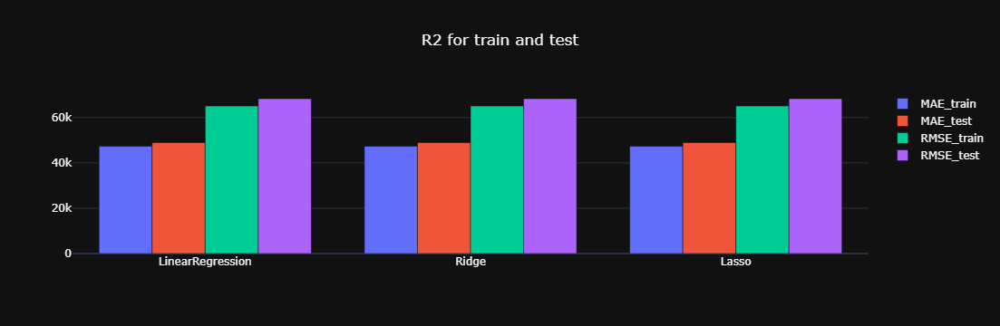

In [423]:
fig = go.Figure(data=[
    # go.Bar(name='r2_train', x=df_models.Algorithm, y=df_models.r2_train),
    # go.Bar(name='r2_test', x=df_models.Algorithm, y=df_models.r2_test),
    go.Bar(name='MAE_train', x=df_models.Algorithm, y=df_models.MAE_train),
    go.Bar(name='MAE_test', x=df_models.Algorithm, y=df_models.MAE_test),
    go.Bar(name='RMSE_train', x=df_models.Algorithm, y=df_models.RMSE_train),
    go.Bar(name='RMSE_test', x=df_models.Algorithm, y=df_models.RMSE_test),
    
])
fig.update_layout(template='plotly_dark', title='R2 for train and test', title_x=0.5)

In [513]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import Ridge

ridge = Ridge(alpha=20)
rfe = RFE(estimator=ridge, n_features_to_select=6)
rfe.fit(x_train_final_linear, y_train_final_linear)

# Selected features
selected_features_Linear = x_train_final_linear.columns[rfe.support_]
print("Top 10 features by RFE:", list(selected_features))


Top 10 features by RFE: ['longitude', 'latitude', 'housing_median_age', 'total_rooms', 'total_bedrooms', 'median_income', 'rooms_per_household', 'bedrooms_per_room', 'population_per_household', 'population_density', 'location_sum', 'location_diff', 'location_div', 'income_age_interaction', 'ocean_proximity_label']


In [514]:
from sklearn.linear_model import Ridge
from sklearn.metrics import r2_score

# Fit Ridge with all features
ridge_all = Ridge(alpha=20)
ridge_all.fit(x_train_final_linear, y_train_final_linear)
r2_all = r2_score(y_train_final_linear, ridge_all.predict(x_train_final_linear))

# Fit Ridge only with selected features
X_train_selected = x_train_final_linear[selected_features_Linear]
ridge_selected = Ridge(alpha=20)
ridge_selected.fit(X_train_selected, y_train_final_linear)
r2_selected = r2_score(y_train_final_linear, ridge_selected.predict(X_train_selected))

# Comparison
print(f"R² with all features:      {r2_all:.4f}")
print(f"R² with selected features: {r2_selected:.4f}")
print(f"Variance retained:         {(r2_selected / r2_all) * 100:.2f}%")


R² with all features:      0.6315
R² with selected features: 0.6116
Variance retained:         96.85%


In [516]:
x_train_final_linear = x_train_final_linear[selected_features_Linear]
x_test_final_linear = x_test_final_linear[selected_features_Linear]

In [480]:
x_train_final_linear.shape, x_test_final_linear.shape

((12718, 6), (5487, 6))

In [518]:
# from sklearn.linear_model import Ridge
# from sklearn.model_selection import GridSearchCV, cross_val_score

# Define parameter grid for Ridge
param_grid = {
    'alpha': [0.01], #, 0.1, 1, 10, 20, 50, 100],  # Regularization strength
    'solver': ['lsqr'], #, 'svd', 'cholesky', 'sag', 'saga'],  # Solvers for ridge
    'fit_intercept': [True], #, False],
    'tol': [1e-4] #1e-3 ,  1e-5]
}

# Create the Ridge regressor
ridge = Ridge()

# Set up GridSearchCV
grid_search = GridSearchCV(estimator=ridge,
                           param_grid=param_grid,
                           scoring='r2',  # You can use other scoring metrics too, like 'neg_mean_squared_error'
                           cv=5,
                           n_jobs=-1,
                           verbose=1)

# Fit to training data
grid_search.fit(x_train_final_linear, y_train_final_linear)

# Best model from grid search
best_ridge = grid_search.best_estimator_

# Print best parameters
print("Best Parameters for Ridge:", grid_search.best_params_)

# Evaluate model
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

y_train_pred = best_ridge.predict(x_train_final_linear)
y_test_pred = best_ridge.predict(x_test_final_linear)

print("R² Train:", r2_score(y_train_final_linear, y_train_pred))
print("R² Test:", r2_score(y_test_final_linear, y_test_pred))
print("MAE Test:", mean_absolute_error(y_test_final_linear, y_test_pred))
# print("RMSE Test:", mean_squared_error(y_test_final_linear, y_test_pred, squared=False))

# Cross-validation R²
cv_scores = cross_val_score(best_ridge, x_train_final_linear, y_train_final_linear, cv=5, scoring='r2')
print("Cross-validated R² scores:", cv_scores)
print("Mean CV R²:", cv_scores.mean())


Fitting 5 folds for each of 1 candidates, totalling 5 fits
Best Parameters for Ridge: {'alpha': 0.01, 'fit_intercept': True, 'solver': 'lsqr', 'tol': 0.0001}
R² Train: 0.6116335997537541
R² Test: 0.601533552583819
MAE Test: 49488.98608935408
Cross-validated R² scores: [0.62239537 0.59157457 0.62375925 0.62640264 0.58791109]
Mean CV R²: 0.6104085833382363


## მთავარი გამოწვევა იყო Feature Selection. განსხვავებული მიდგომა სჭირდება მოდელებს, ზოგს რაც შეიძლება ბევრი ფიჩერი და მერე ბორუტა მოუხდა, ზოგს პირიქით მაღალ კორელაციური ფიჩერების წაშლა. დიდად ჰიპერპარამეტრების ტუნინგით უკეთესს შედეგებზე ვერ გავედით. ოვერფიტი ცოტათი შევამცირე მაგრამ ჰიპერპარამეტრების ტუნინგის გარდა კიდევ სხვა ვარიანტებიც საჭიროა.